In [1]:
import numpy as np
import pandas as pd
import scipy
from scipy import stats
import suncalc

import dask.dataframe as dd
from pathlib import Path
import glob

import datetime as dt

import matplotlib.pyplot as plt
from matplotlib import colors
import soundfile as sf
import matplotlib.patches as patches

In [2]:
import sys

sys.path.append("../src")
sys.path.append("../src/activity")

In [3]:
import subsampling as ss
import activity_assembly as actvt
from core import SITE_NAMES, FREQ_GROUPS, SEATTLE_LATITUDE, SEATTLE_LONGITUDE

from cli import get_file_paths
import plot
import pipeline

In [4]:
avail = np.arange(0, 720, 3) + 3
reset_24 = avail[np.where((24*60 % avail) == 0)[0]]
reset_24

array([  3,   6,   9,  12,  15,  18,  24,  30,  36,  45,  48,  60,  72,
        90,  96, 120, 144, 180, 240, 288, 360, 480, 720])

In [5]:
cycle_lengths = reset_24
percent_ons = [1/3]
specific_dc_tag = "30of30"

data_params = dict()
data_params["cycle_lengths"] = cycle_lengths
data_params["percent_ons"] = percent_ons
dc_tags = ss.get_list_of_dc_tags(data_params["cycle_lengths"], data_params["percent_ons"])
data_params["dc_tags"] = dc_tags
data_params["cur_dc_tag"] = specific_dc_tag
data_params['bin_size'] = '30'
data_params['index_time_block_in_secs'] = '5'
data_params['recording_start'] = '00:00'
data_params['recording_end'] = '16:00'

pipeline_params = dict()
pipeline_params['assemble_location_summary'] = False
pipeline_params["read_csv"] = False
pipeline_params["save_activity_grid"] = False
pipeline_params["save_presence_grid"] = False
pipeline_params["save_dc_night_comparisons"] = False
pipeline_params["save_activity_dc_comparisons"] = False
pipeline_params["save_presence_dc_comparisons"] = False
pipeline_params["show_plots"] = True
pipeline_params["show_PST"] = True

In [6]:
data_params["dc_tags"]

['30of30',
 '1of3',
 '2of6',
 '3of9',
 '4of12',
 '5of15',
 '6of18',
 '8of24',
 '10of30',
 '12of36',
 '15of45',
 '16of48',
 '20of60',
 '24of72',
 '30of90',
 '32of96',
 '40of120',
 '48of144',
 '60of180',
 '80of240',
 '96of288',
 '120of360',
 '160of480',
 '240of720']

In [7]:
site_key = 'Telephone'
type_key = 'HF2'
print(site_key, type_key)

data_params["site_name"] = SITE_NAMES[site_key]
data_params["site_tag"] = site_key
data_params["type_tag"] = type_key

file_paths = get_file_paths(data_params)

if (pipeline_params['assemble_location_summary']):
    actvt.assemble_initial_location_summary(data_params, file_paths) ## Use to update any bd2__(location summary).csv files

activity_inds_arr = pd.DataFrame()

for dc_tag in data_params['dc_tags']:
    print(dc_tag)

    location_df = ss.prepare_summary_for_plotting_with_duty_cycle(file_paths, dc_tag, data_params['bin_size'])
    activity_indices = actvt.get_activity_index_per_interval(location_df, data_params)
    dc_dets = actvt.construct_activity_indices_arr(activity_indices, dc_tag, file_paths, data_params)
    dc_dets = dc_dets.set_index("datetime_UTC")
    activity_inds_arr = pd.concat([activity_inds_arr, dc_dets], axis=1)


activity_inds_arr

Telephone HF2
30of30
1of3
2of6
3of9
4of12
5of15
6of18
8of24
10of30
12of36
15of45
16of48
20of60
24of72
30of90
32of96
40of120
48of144
60of180
80of240
96of288
120of360
160of480
240of720


,activity_index (30of30),activity_index (1of3),activity_index (2of6),activity_index (3of9),activity_index (4of12),activity_index (5of15),activity_index (6of18),activity_index (8of24),activity_index (10of30),activity_index (12of36),...,activity_index (30of90),activity_index (32of96),activity_index (40of120),activity_index (48of144),activity_index (60of180),activity_index (80of240),activity_index (96of288),activity_index (120of360),activity_index (160of480),activity_index (240of720)
datetime_UTC,,,,,,,,,,,,,,,,,,,,,
2022-07-23 00:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-07-23 00:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-07-23 01:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-07-23 01:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-07-23 02:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-17 13:30:00,69.0,30.0,25.0,25.0,23.0,23.0,18.0,46.0,41.0,0.0,...,69.0,0.0,0.0,0.0,0.0,0.0,0.0,69.0,0.0,69.0
2022-10-17 14:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-10-17 14:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
activity_inds_arr.loc[dt.datetime(2022, 8, 19, 0, 0, 0):dt.datetime(2022, 8, 21, 16, 0, 0)]

,activity_index (30of30),activity_index (1of3),activity_index (2of6),activity_index (3of9),activity_index (4of12),activity_index (5of15),activity_index (6of18),activity_index (8of24),activity_index (10of30),activity_index (12of36),...,activity_index (30of90),activity_index (32of96),activity_index (40of120),activity_index (48of144),activity_index (60of180),activity_index (80of240),activity_index (96of288),activity_index (120of360),activity_index (160of480),activity_index (240of720)
datetime_UTC,,,,,,,,,,,,,,,,,,,,,
2022-08-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 00:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 01:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-08-19 01:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-08-19 02:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-21 13:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-08-21 14:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-08-21 14:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [9]:
high_actvt_indices = activity_inds_arr.loc[dt.datetime(2022, 8, 19, 0, 0, 0):dt.datetime(2022, 8, 21, 16, 0, 0)].copy()

for col_name in high_actvt_indices.columns:
    dc_tag = col_name.split('(')[-1].split(')')[0]
    on = int(dc_tag.split('of')[0])
    total = int(dc_tag.split('of')[-1])
    bin_size = int(data_params['bin_size'])
    dc_actvt = high_actvt_indices[col_name].copy()


    recover_ratio = min(total, bin_size) / min(on, bin_size)
    rep_dc_actvt = dc_actvt * recover_ratio

    if total-on >= bin_size:
        print(dc_tag)
        high_actvt_indices[col_name] = rep_dc_actvt.replace(np.NaN, -1).replace(0, np.NaN).ffill(limit=(min((14*60)-on, total-on)//bin_size)).replace(np.NaN, 0).replace(-1, np.NaN)
    else:
        high_actvt_indices[col_name] = rep_dc_actvt

15of45
16of48
20of60
24of72
30of90
32of96
40of120
48of144
60of180
80of240
96of288
120of360
160of480
240of720


In [10]:
high_actvt_indices

,activity_index (30of30),activity_index (1of3),activity_index (2of6),activity_index (3of9),activity_index (4of12),activity_index (5of15),activity_index (6of18),activity_index (8of24),activity_index (10of30),activity_index (12of36),...,activity_index (30of90),activity_index (32of96),activity_index (40of120),activity_index (48of144),activity_index (60of180),activity_index (80of240),activity_index (96of288),activity_index (120of360),activity_index (160of480),activity_index (240of720)
datetime_UTC,,,,,,,,,,,,,,,,,,,,,
2022-08-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 00:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 01:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 01:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 02:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-21 13:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,4.0,4.0,4.0,4.0,3.0,4.0,29.0,4.0
2022-08-21 14:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,4.0,4.0,4.0,3.0,4.0,29.0,4.0
2022-08-21 14:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,4.0,4.0,0.0,4.0,29.0,4.0


In [11]:
high_actvt_indices_rate = high_actvt_indices * (2 / 1)

In [12]:
high_actvt_indices_rate

,activity_index (30of30),activity_index (1of3),activity_index (2of6),activity_index (3of9),activity_index (4of12),activity_index (5of15),activity_index (6of18),activity_index (8of24),activity_index (10of30),activity_index (12of36),...,activity_index (30of90),activity_index (32of96),activity_index (40of120),activity_index (48of144),activity_index (60of180),activity_index (80of240),activity_index (96of288),activity_index (120of360),activity_index (160of480),activity_index (240of720)
datetime_UTC,,,,,,,,,,,,,,,,,,,,,
2022-08-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 00:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 01:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 01:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-08-19 02:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-21 13:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,8.0,8.0,8.0,8.0,6.0,8.0,58.0,8.0
2022-08-21 14:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,8.0,8.0,8.0,6.0,8.0,58.0,8.0
2022-08-21 14:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,8.0,8.0,0.0,8.0,58.0,8.0


In [13]:
exp_dc_ind_rate_mean = high_actvt_indices_rate.mean()[1:]
control_dc_ind_rate_mean = high_actvt_indices_rate.mean()[0]

In [14]:
time_ons = []
c_lengths = []
for col_name in exp_dc_ind_rate_mean.index:
    dc_tag = col_name.split('(')[-1].split(')')[0]
    on = int(dc_tag.split('of')[0])
    total = int(dc_tag.split('of')[-1])
    time_ons.append(on)
    c_lengths.append(total)

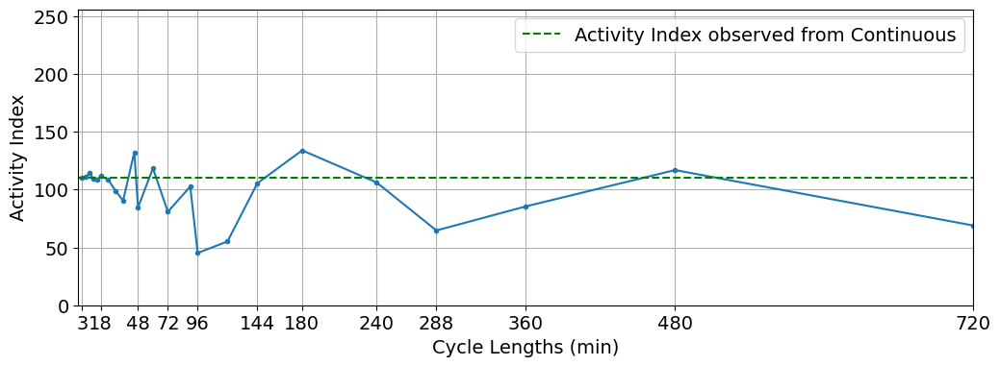

In [15]:
plt.figure(figsize=(12, 4))
plt.rcParams.update({'font.size':14})
plt.plot(c_lengths, exp_dc_ind_rate_mean,  marker='.')
plt.axhline(control_dc_ind_rate_mean, linestyle='dashed', color='g', label=f'Activity Index observed from Continuous')
plt.xlabel('Cycle Lengths (min)')
plt.ylabel('Activity Index')
plot_log_labels = np.concatenate([c_lengths[:8], c_lengths[8:16:2], c_lengths[16:20:2], c_lengths[20:]]).astype('int')
plot_lin_labels = np.concatenate([c_lengths[:10:5], c_lengths[10:16:2], c_lengths[16::]]).astype('int')
# plt.xscale('log')
# plt.xlim(2**np.floor(np.log2(time_ons[0])), 
#          2**np.ceil(np.log2(time_ons[-1])))
plt.xlim(0, c_lengths[-1])
plt.xticks(plot_lin_labels, plot_lin_labels)
plt.ylim(0, 2**np.ceil(np.log2(exp_dc_ind_rate_mean.max())))
plt.legend()
plt.grid(which='both')
plt.show()

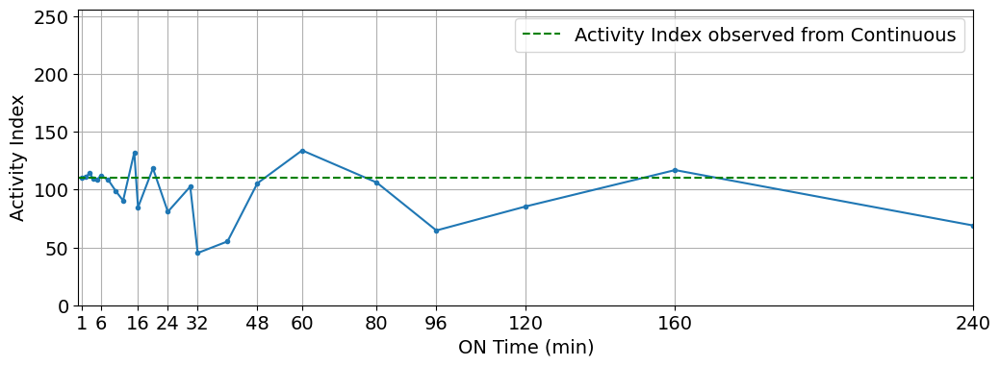

In [16]:
plt.figure(figsize=(12, 4))
plt.rcParams.update({'font.size':14})
plt.plot(time_ons, exp_dc_ind_rate_mean, marker='.')
plt.axhline(control_dc_ind_rate_mean, linestyle='dashed', color='g', label=f'Activity Index observed from Continuous')
plt.xlabel('ON Time (min)')
plt.ylabel('Activity Index')
plot_log_labels = np.concatenate([time_ons[:8], time_ons[8:16:2], time_ons[16:20:2], time_ons[20:]]).astype('int')
plot_lin_labels = np.concatenate([time_ons[:10:5], time_ons[10:16:2], time_ons[16::]]).astype('int')
# plt.xscale('log')
# plt.xlim(2**np.floor(np.log2(time_ons[0])), 
#          2**np.ceil(np.log2(time_ons[-1])))
plt.xlim(0, time_ons[-1])
plt.xticks(plot_lin_labels, plot_lin_labels)
plt.ylim(0, 2**np.ceil(np.log2(exp_dc_ind_rate_mean.max())))
plt.legend()
plt.grid(which='both')
plt.show()

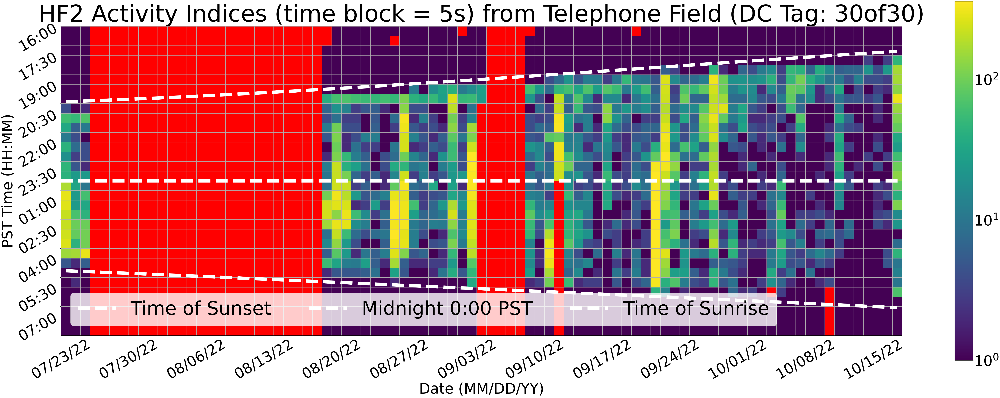

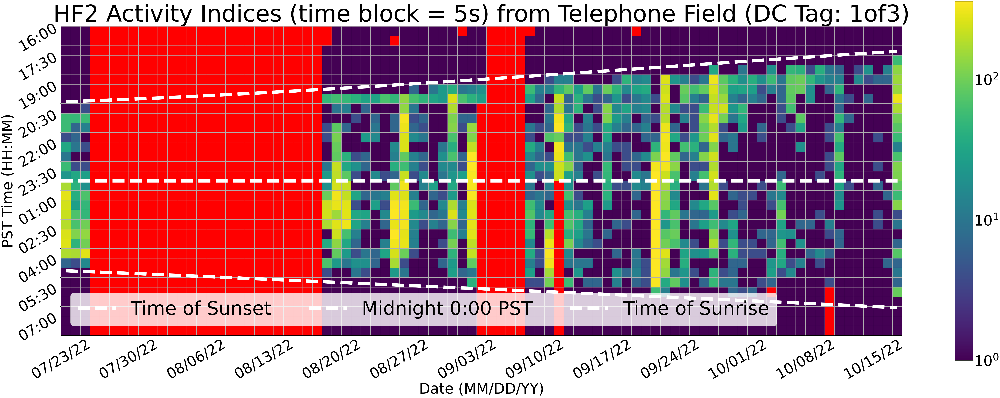

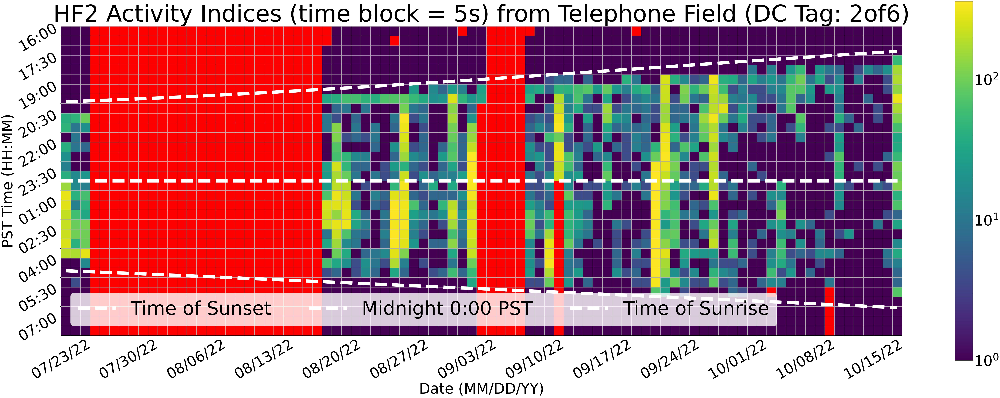

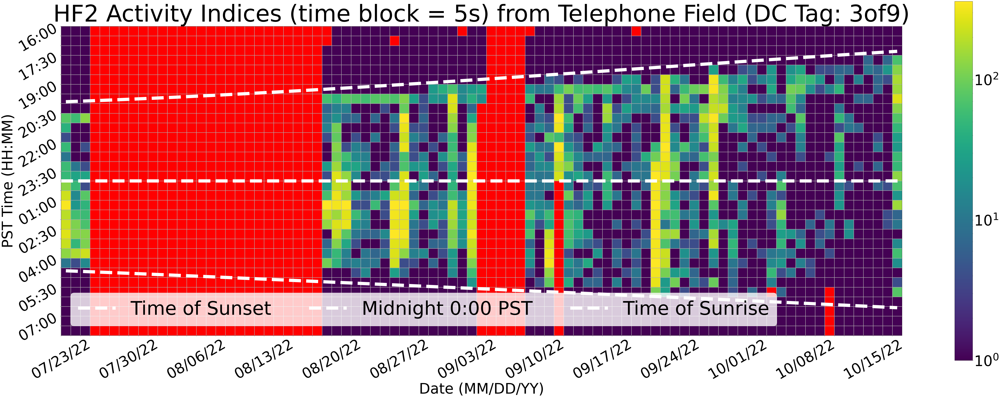

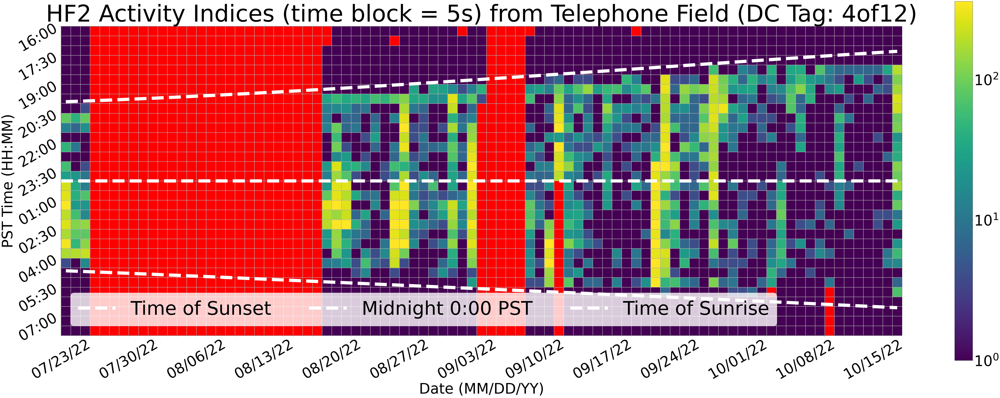

...

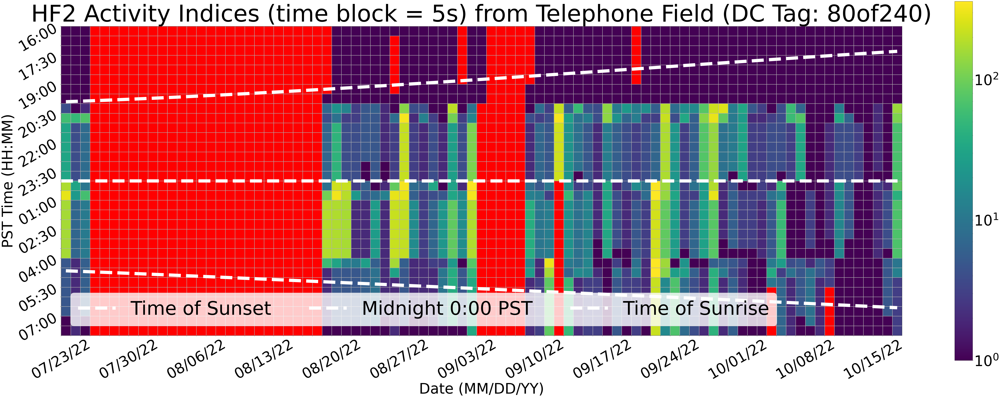

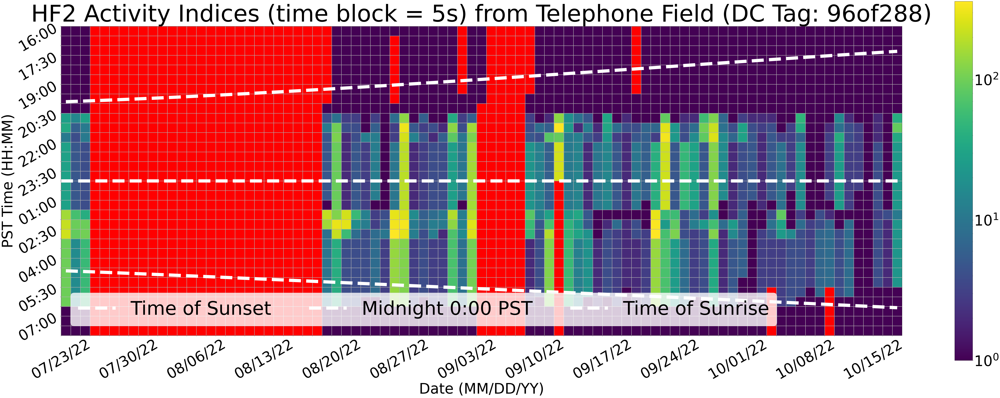

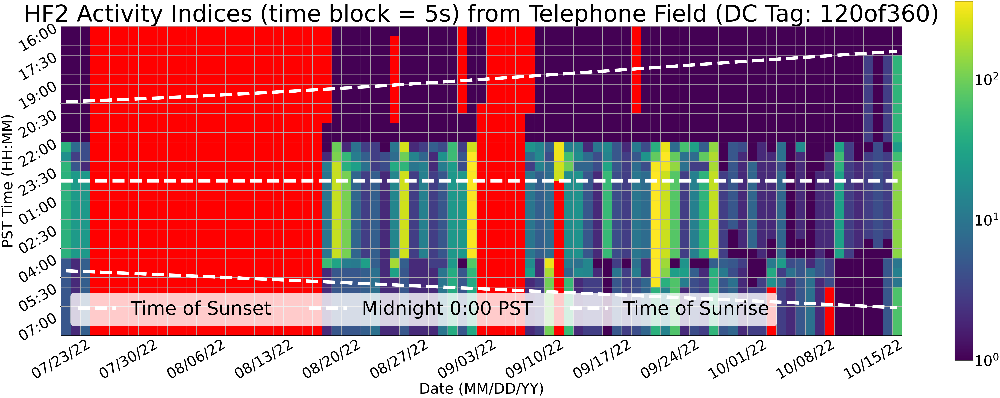

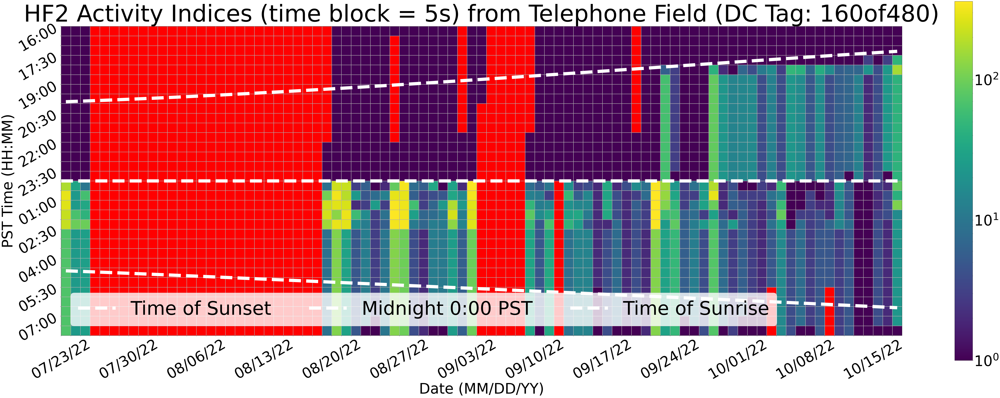

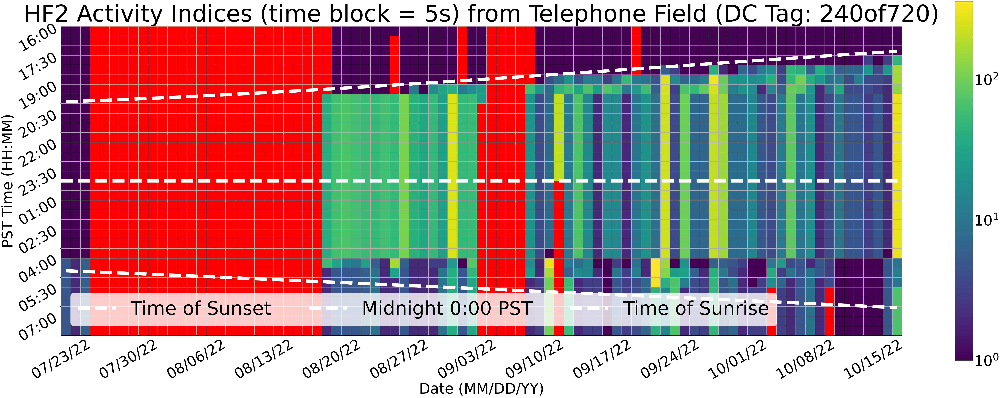

In [17]:
for dc_tag in dc_tags:
    data_params["cur_dc_tag"] = dc_tag
    plot.plot_activity_grid_for_inds(activity_inds_arr, data_params, pipeline_params, file_paths)